# Coronavirus Data Analysis

<hr style="height:2pt">

## Table of Contents
1. [Introduction](#introduction)
2. [Data loading and cleaning](#data_cleaning)
3. [Case data by provinces: Korea](#province_cases)

In [217]:
import pandas as pd
import numpy as np
import datetime
import os

import folium
import geopandas as gpd

import seaborn as sns
import matplotlib.pyplot as plt
from branca.colormap import linear

## Johns Hopkins

In [24]:
# load data: fetch directly from Johns Hopkins University's github
url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_19-covid-Confirmed.csv'
covid19 = pd.read_csv(url,index_col=0,parse_dates=[0])
covid19.head()

,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,...,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20
Province/State,,,,,,,,,,,,,,,,,,,,,
NaN,Thailand,15.0000,101.0000,2,3,5,7,8,8,14,...,50,53,59,70,75,82,114,147,177,212
NaN,Japan,36.0000,138.0000,2,1,2,2,4,4,7,...,511,581,639,639,701,773,839,825,878,889
NaN,Singapore,1.2833,103.8333,0,1,3,3,4,5,7,...,150,160,178,178,200,212,226,243,266,313
NaN,Nepal,28.1667,84.2500,0,0,0,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
NaN,Malaysia,2.5000,112.5000,0,0,0,3,4,4,4,...,117,129,149,149,197,238,428,566,673,790


<a id='introduction'></a>
## Introduction
<hr style="height:1pt">

The following data comes from the [Data Science For Covid-19 Project](https://github.com/jihoo-kim/Data-Science-for-COVID-19), which pulls individual case data from Korea Centers for Disease Control & Prevention (KCDC)

<a id='data_cleaning'></a>
## Korean CDC
## Load and clean data
<hr style="height:1pt">

### Geographic province data

In [182]:
# load geo-json of SK provinces as geopandas object
geo_url = "https://raw.githubusercontent.com/southkorea/southkorea-maps/master/gadm/json/skorea-provinces-geo.json"
kor_prov = gpd.read_file(geo_url)

### Patients

In [110]:
url = 'https://raw.githubusercontent.com/jihoo-kim/Data-Science-for-COVID-19/master/dataset/Patient/PatientInfo.csv'
patients = pd.read_csv(url, index_col=0,parse_dates=[1])
patients.head()

,global_num,sex,birth_year,age,country,province,city,disease,infection_case,infection_order,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
patient_id,,,,,,,,,,,,,,,,,
1000000001,2,male,1964.0,50s,Korea,Seoul,Gangseo-gu,NaN,overseas inflow,1.0,NaN,75.0,2020-01-22,2020-01-23,2020-02-05,NaN,released
1000000002,5,male,1987.0,30s,Korea,Seoul,Jungnang-gu,NaN,overseas inflow,1.0,NaN,31.0,NaN,2020-01-30,2020-03-02,NaN,released
1000000003,6,male,1964.0,50s,Korea,Seoul,Jongno-gu,NaN,contact with patient,2.0,2.002000e+09,17.0,NaN,2020-01-30,2020-02-19,NaN,released
1000000004,7,male,1991.0,20s,Korea,Seoul,Mapo-gu,NaN,overseas inflow,1.0,NaN,9.0,2020-01-26,2020-01-30,2020-02-15,NaN,released
1000000005,9,female,1992.0,20s,Korea,Seoul,Seongbuk-gu,NaN,contact with patient,2.0,1.000000e+09,2.0,NaN,2020-01-31,2020-02-24,NaN,released


In [111]:
# convert dates to datetime datatypes
patients["confirmed_date"] = pd.to_datetime(patients["confirmed_date"])
patients["released_date"] = pd.to_datetime(patients["released_date"])

### Weather


In [112]:
url = 'https://raw.githubusercontent.com/jihoo-kim/Data-Science-for-COVID-19/master/dataset/Weather.csv'
weather = pd.read_csv(url, index_col=0,parse_dates=[1])

# convert dates to datetime datatypes
weather["date"] = pd.to_datetime(weather["date"])
weather.head()    

,province,date,avg_temp,min_temp,max_temp,precipitation,max_wind_speed,most_wind_direction,avg_relative_humidity
code,,,,,,,,,
10000,Seoul,2016-03-17,9.3,2.0,14.7,0.0,3.2,70.0,40.9
10000,Seoul,2016-03-18,13.4,8.8,20.1,0.0,5.0,110.0,50.0
10000,Seoul,2016-03-19,11.4,6.6,18.1,0.0,4.8,320.0,58.3
10000,Seoul,2016-03-20,10.6,4.9,17.5,0.0,4.6,320.0,54.0
10000,Seoul,2016-03-21,9.9,5.5,16.1,0.0,5.4,320.0,54.1


### Case counts

In [193]:
# build index for each province 
province_lookup = {}

for i in range(kor_prov.shape[0]):
    province_lookup[kor_prov.loc[i]["NAME_1"]] = i
    
province_lookup

{'Busan': 0,
 'Chungcheongbuk-do': 1,
 'Chungcheongnam-do': 2,
 'Daegu': 3,
 'Daejeon': 4,
 'Gangwon-do': 5,
 'Gwangju': 6,
 'Gyeonggi-do': 7,
 'Gyeongsangbuk-do': 8,
 'Gyeongsangnam-do': 9,
 'Incheon': 10,
 'Jeju': 11,
 'Jeollabuk-do': 12,
 'Jeollanam-do': 13,
 'Seoul': 14,
 'Ulsan': 15}

In [194]:
url = 'https://raw.githubusercontent.com/jihoo-kim/Data-Science-for-COVID-19/master/dataset/Time/TimeProvince.csv'
cases = pd.read_csv(url, index_col=0,parse_dates=[1])
cases = cases.reset_index()

# convert dates to datetime datatypes
cases["date"] = pd.to_datetime(cases["date"])

# rename jeju-do to match geo-data
cases["province"] = cases["province"].replace("Jeju-do", "Jeju")

# fetch province_id
cases["province_id"] = cases["province"].map(province_lookup).astype("object")


cases.head()

,date,time,province,confirmed,released,deceased,province_id
0,2020-01-20,16,Seoul,0,0,0,14
1,2020-01-20,16,Busan,0,0,0,0
2,2020-01-20,16,Daegu,0,0,0,3
3,2020-01-20,16,Incheon,1,0,0,10
4,2020-01-20,16,Gwangju,0,0,0,6


### Region data

In [114]:
url = 'https://raw.githubusercontent.com/jihoo-kim/Data-Science-for-COVID-19/master/dataset/Region.csv'
regions = pd.read_csv(url, index_col=0,parse_dates=[1])

regions.head()    

,province,city,latitude,longitude,elementary_school_count,kindergarten_count,university_count,academy_ratio,elderly_population_ratio,elderly_alone_ratio,nursing_home_count
code,,,,,,,,,,,
10000,Seoul,Seoul,37.566953,126.977977,607,830,48,1.44,15.38,5.8,22739
10010,Seoul,Gangnam-gu,37.518421,127.047222,33,38,0,4.18,13.17,4.3,3088
10020,Seoul,Gangdong-gu,37.530492,127.123837,27,32,0,1.54,14.55,5.4,1023
10030,Seoul,Gangbuk-gu,37.639938,127.025508,14,21,0,0.67,19.49,8.5,628
10040,Seoul,Gangseo-gu,37.551166,126.849506,36,56,1,1.17,14.39,5.7,1080


<a id='province_cases'></a>
## Case data by provinces: Korea
https://www.kaggle.com/mbnb8317/ds4c-time-series-geospatial-eda-using-folium
<hr style="height:1pt">

In [115]:
# load geo-json of SK provinces, and fetch latest case data
province_geo = "https://raw.githubusercontent.com/southkorea/southkorea-maps/master/gadm/json/skorea-provinces-geo.json"
cases_data = cases.loc[cases["date"] == cases["date"].max()]
date = datetime.datetime.date(cases["date"].max())

In [195]:
# use folium to show map of Seoul area
m = folium.Map(location=[37.566953, 126.977977], zoom_start=7)

folium.Choropleth(
    geo_data=province_geo,
    name='choropleth',
    data=cases_data,
    columns=['province', 'confirmed'],
    key_on='feature.properties.NAME_1',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name=f'Case numbers as of {date}'
).add_to(m)

folium.LayerControl().add_to(m)

m

In [84]:
# plot over time
# https://github.com/halfdanrump/geoviz/blob/master/pyconjp2017/presentation.ipynb
# https://github.com/python-visualization/folium/blob/master/examples/TimeSliderChoropleth.ipynb
# https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/TimeSliderChoropleth.ipynb

In [196]:
# create datetime index
dt_index = (cases["date"].astype(int) // 10**9).astype('U10').unique()
dt_index

array(['1579478400', '1579564800', '1579651200', '1579737600',
       '1579824000', '1579910400', '1579996800', '1580083200',
       '1580169600', '1580256000', '1580342400', '1580428800',
       '1580515200', '1580601600', '1580688000', '1580774400',
       '1580860800', '1580947200', '1581033600', '1581120000',
       '1581206400', '1581292800', '1581379200', '1581465600',
       '1581552000', '1581638400', '1581724800', '1581811200',
       '1581897600', '1581984000', '1582070400', '1582156800',
       '1582243200', '1582329600', '1582416000', '1582502400',
       '1582588800', '1582675200', '1582761600', '1582848000',
       '1582934400', '1583020800', '1583107200', '1583193600',
       '1583280000', '1583366400', '1583452800', '1583539200',
       '1583625600', '1583712000', '1583798400', '1583884800',
       '1583971200', '1584057600', '1584144000', '1584230400',
       '1584316800', '1584403200', '1584489600', '1584576000',
       '1584662400'], dtype=object)

In [198]:
styledata = {}

for province in kor_prov.index:
    df = pd.DataFrame({
        "color": cases.loc[cases["province_id"] == province]["confirmed"].values,
        "opacity": 0.7
    }, index=dt_index)
    
    styledata[province] = df
    

In [200]:
styledata.get(0)

,color,opacity
1579478400,0,0.7
1579564800,0,0.7
1579651200,0,0.7
1579737600,0,0.7
1579824000,0,0.7
...,...,...
1584316800,107,0.7
1584403200,52,0.7
1584489600,48,0.7
1584576000,48,0.7


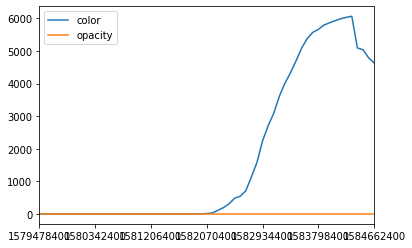

In [205]:
styledata.get(3).plot()

In [206]:
min_color = cases["confirmed"].min()
max_color = cases["confirmed"].max()

print(min_color, max_color)

0 6066


In [208]:
max_color, min_color, max_opacity, min_opacity = 0, 0, 0, 0

for province, data in styledata.items():
    max_color = max(max_color, data['color'].max())
    min_color = min(max_color, data['color'].min())
    max_opacity = max(max_color, data['opacity'].max())
    max_opacity = min(max_color, data['opacity'].max())
    
print(max_color, min_color, max_opacity, min_opacity)

6066 0 0.7 0


In [212]:
cmap = linear.OrRd_09.scale(min_color, max_color)


def norm(x):
    return (x - x.min()) / (x.max() - x.min())


for country, data in styledata.items():
    data['color'] = data['color'].apply(cmap)

{0:                 color  opacity
 1579478400  #fff7ecff      0.7
 1579564800  #fff7ecff      0.7
 1579651200  #fff7ecff      0.7
 1579737600  #fff7ecff      0.7
 1579824000  #fff7ecff      0.7
 ...               ...      ...
 1584316800  #fff5e7ff      0.7
 1584403200  #fff6eaff      0.7
 1584489600  #fff7eaff      0.7
 1584576000  #fff7eaff      0.7
 1584662400  #fff7eaff      0.7
 
 [61 rows x 2 columns], 1:                 color  opacity
 1579478400  #fff7ecff      0.7
 1579564800  #fff7ecff      0.7
 1579651200  #fff7ecff      0.7
 1579737600  #fff7ecff      0.7
 1579824000  #fff7ecff      0.7
 ...               ...      ...
 1584316800  #fff7ebff      0.7
 1584403200  #fff7ebff      0.7
 1584489600  #fff7ebff      0.7
 1584576000  #fff7ebff      0.7
 1584662400  #fff7ebff      0.7
 
 [61 rows x 2 columns], 2:                 color  opacity
 1579478400  #fff7ecff      0.7
 1579564800  #fff7ecff      0.7
 1579651200  #fff7ecff      0.7
 1579737600  #fff7ecff      0.7
 1579824000  

In [213]:
styledict = {
    str(country): data.to_dict(orient='index') for
    country, data in styledata.items()
}

In [243]:
from folium.plugins import TimeSliderChoropleth

m = folium.Map(location=[37.566953, 126.977977], zoom_start=6)

g = TimeSliderChoropleth(
    kor_prov.to_json(),
    styledict=styledict,

).add_to(m)

m.save(os.path.join('./output', 'TimeSliderChoropleth.html'))

m

<a id='province_cases'></a>
## Case data by state: USA
https://github.com/CSSEGISandData/COVID-19
<hr style="height:1pt">

In [229]:
# load geo-json of as geopandas object
geo_url = "https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json"
usa_geo = gpd.read_file(geo_url)

In [233]:
usa_geo.head()

,id,name,density,geometry
0,01,Alabama,94.650,"POLYGON ((-87.359 35.001, -85.607 34.985, -85...."
1,02,Alaska,1.264,"MULTIPOLYGON (((-131.602 55.118, -131.569 55.2..."
2,04,Arizona,57.050,"POLYGON ((-109.043 37.000, -109.048 31.332, -1..."
3,05,Arkansas,56.430,"POLYGON ((-94.474 36.502, -90.153 36.496, -90...."
4,06,California,241.700,"POLYGON ((-123.233 42.006, -122.379 42.012, -1..."


In [244]:
list(usa_geo["name"])

['Alabama',
 'Alaska',
 'Arizona',
 'Arkansas',
 'California',
 'Colorado',
 'Connecticut',
 'Delaware',
 'District of Columbia',
 'Florida',
 'Georgia',
 'Hawaii',
 'Idaho',
 'Illinois',
 'Indiana',
 'Iowa',
 'Kansas',
 'Kentucky',
 'Louisiana',
 'Maine',
 'Maryland',
 'Massachusetts',
 'Michigan',
 'Minnesota',
 'Mississippi',
 'Missouri',
 'Montana',
 'Nebraska',
 'Nevada',
 'New Hampshire',
 'New Jersey',
 'New Mexico',
 'New York',
 'North Carolina',
 'North Dakota',
 'Ohio',
 'Oklahoma',
 'Oregon',
 'Pennsylvania',
 'Rhode Island',
 'South Carolina',
 'South Dakota',
 'Tennessee',
 'Texas',
 'Utah',
 'Vermont',
 'Virginia',
 'Washington',
 'West Virginia',
 'Wisconsin',
 'Wyoming',
 'Puerto Rico']

In [245]:
states = []
for i in usa_cases.index:
    if i in list(usa_geo["name"]):
        states.append(i)

len(states)

52

In [253]:
url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_19-covid-Confirmed.csv'
world_cases = pd.read_csv(url, index_col=0,parse_dates=[0])
# cases = cases.reset_index()

usa_cases = world_cases.loc[world_cases["Country/Region"] == "US"]
usa_cases["State"] = usa_cases.index
usa_cases = usa_cases.loc[usa_cases['State'].isin(list(usa_geo["name"]))].sort_values(by="State")



/Users/austinrochon/Documents/6.Harvard/harvard-coursework/ac209a/labs/lab1/cs109a/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [256]:
al = usa_cases.loc[usa_cases["State"] == "Alabama"]
al
pd.melt(al, id_vars=["Country/Region", "Lat"])

,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,...,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,State
Province/State,,,,,,,,,,,,,,,,,,,,,
Alabama,US,32.3182,-86.9023,0,0,0,0,0,0,0,...,5,6,12,29,39,46,78,83,131,Alabama
